<a href="https://colab.research.google.com/github/capofwesh20/Real-Time-YOLO-Traffic-Density-Estimation/blob/main/YOLOv8_Real_Time_Traffic_Density_Estimation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
!pip install ultralytics supervision

In [ ]:
%%capture
!pip install wandb


In [ ]:
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video
from moviepy.editor import VideoFileClip

In [ ]:
# Load a pretrained YOLOv8s model from Ultralytics
model = YOLO('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 163MB/s]



image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 4 cars, 1 truck, 430.0ms
Speed: 21.9ms preprocess, 430.0ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


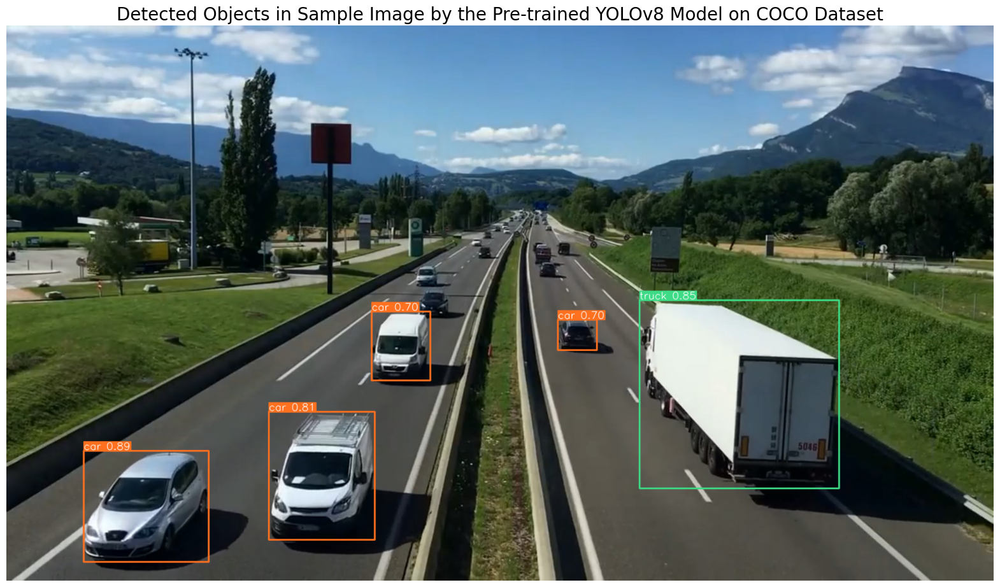

In [ ]:
# Path to the image file
image_path = '/content/drive/MyDrive/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.6)   # Confidence threshold: 60% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

# **Pre-trained Model Detection Analysis**
In our sample image, the pre-trained model missed the detectable truck and car that were clearly visible. A model pre-trained on a dataset with a broad range of classes, like COCO's 80 different categories, may not perform as well on a specific subset of those categories due to the diversity of objects it has been trained to recognize. If we fine-tune this model on a specialized dataset that focuses solely on vehicles, it can learn to detect various types of vehicles more accurately. Fine-tuning on a vehicle-specific dataset allows the model to become more specialized, adjusting the weights to be more sensitive to features specific to vehicles. As a result, the model's mean Average Precision (mAP) for vehicle detection could improve because it's being optimized on a narrower, more relevant range of classes for our specific application. Fine-tuning also helps the model generalize better for vehicle detection tasks, potentially reducing false negatives (like missing a detectable truck) and improving overall detection performance.

# **Dataset Exploration**

# Dataset Preparation for Model Fine-tuning
To fine-tune our pre-trained model on a specialized dataset that focuses solely on vehicles, so that it can learn to detect various types of vehicles more accurately, I have prepared a dataset which is available at this link Top-View Vehicle Detection Image Dataset for YOLOv8s. The dataset zeroes in on the 'Vehicle' class, covering a wide variety of vehicles such as cars, trucks, and buses. It is composed of 626 images sourced from top-view perspectives, annotated meticulously in the YOLOv8 format for effective vehicle detection.

The dataset undergoes a standardization process where each image is resized to a uniform resolution of 640x640 pixels. To bolster the model's ability to generalize, augmentations were applied to the training data, which consists of 536 images. The validation set contains 90 images and remains unaugmented to preserve the integrity of performance evaluation.

This dataset, curated from Pexels, captures the diversity of vehicles from an aerial view, making it ideal for highway monitoring tasks. Each video frame was selected at a sampling rate of 1 frame per second using Roboflow, which facilitated precise annotation for object detection.

# Dataset Format
Our dataset, structured for YOLOv8 format, has been meticulously prepared on Roboflow. It encompasses all necessary components for an efficient object detection model training. Here’s a detailed breakdown:

1️⃣ Train Directory:
The 'train' directory houses our training dataset. It includes 536 images within the 'images' subfolder and corresponding YOLOv8 format labels in the 'labels' subfolder.

2️⃣ Validation Directory:
The 'valid' directory contains the validation dataset. This consists of 90 images in the 'images' subfolder and their respective YOLOv8 format labels in the 'labels' subfolder.

3️⃣ data.yaml:
This file is the Ultralytics YOLO dataset configuration file. It specifies paths to the training and validation datasets, defines the number of classes (1), and the class name ('Vehicle'). This format is crucial for setting up and training the model accurately with our dataset.

📝** Note about labels:**
Labels in our dataset are formatted in YOLO style, where each image is associated with a *.txt file. These files describe the detected objects in a 'class x_center y_center width height' format. Importantly, the box coordinates are normalized between 0 and 1. If an image has no detectable objects, it won’t have a corresponding *.txt file.

# Understanding the data.yaml File
As I previously mentioned, the 'data.yaml' file is a key part of setting up our model. It points out where to find the training and validation images and tells the model that we're focusing on just one class, named 'Vehicle'. This file is essential for making sure our Ultralytics YOLOv8 model learns from our specific dataset, as it guides the model to understand exactly what it needs to look for and where.

In [ ]:
# Define the dataset_path
dataset_path = '/content/drive/MyDrive/Vehicle_Detection_Image_Dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/images
val: ../valid/images



In [ ]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


Let's take a look at a few images from the training dataset to get a sense of what the data looks like:

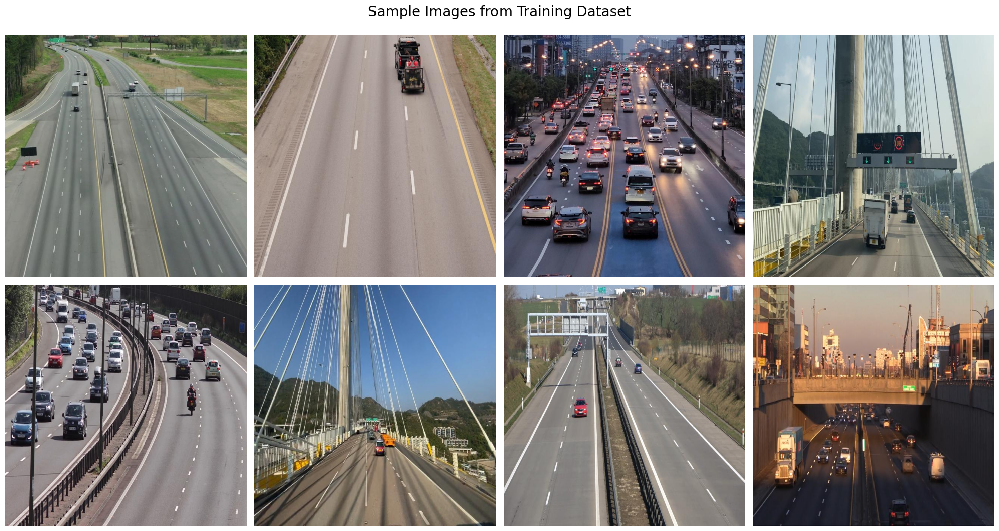

In [ ]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

# **Integration of Weights & Biases (Wandb) with YOLOv8**
Weights & Biases, known as wandb.ai, is an MLOps tool that works seamlessly with Ultralytics, including the YOLOv8 model. When we train our YOLOv8 model, wandb.ai helps to manage our machine learning experiments by monitoring the training process, logging important metrics, and saving outputs. It's like a dashboard where we can see how our model is learning, with all the details and visualizations to help us understand the training progress and results.

In [ ]:
import wandb
wandb.login()


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


True

In [ ]:
from getpass import getpass

key = getpass('Enter WandB API key: ')
wandb.login(key=key)


Enter WandB API key: ··········


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


True

# **Fine-Tuning YOLOv8**

In this step of our project, we're set to fine-tune our YOLOv8 pre-trained object detection model using transfer learning, specifically tailoring it to our 'Top-View Vehicle Detection Image Dataset'. By leveraging the YOLOv8 model's existing weights from its training on the comprehensive COCO dataset, we start from a robust foundation rather than from scratch. This approach not only saves significant time and resources but also capitalizes on our focused dataset to enhance the model's ability to accurately recognize and detect vehicles in top-view images. This method of training enables efficient and effective model adaptation, ensuring it's finely attuned to the specificities of vehicle detection from aerial perspectives:

In [ ]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=150,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=50,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

Ultralytics YOLOv8.1.26 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/Vehicle_Detection_Image_Dataset/data.yaml, epochs=150, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop

100%|██████████| 755k/755k [00:00<00:00, 39.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 171MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/train/labels... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [04:23<00:00,  2.03it/s]


train: New cache created: /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/labels... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [01:23<00:00,  1.08it/s]

val: New cache created: /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      8.11G       1.26      1.381      1.054        377        640: 100%|██████████| 17/17 [00:19<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.88s/it]

                   all         90        937      0.715      0.798      0.798      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      8.19G      1.078      0.723     0.9829        368        640: 100%|██████████| 17/17 [00:13<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         90        937       0.46       0.61      0.433      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      8.29G      1.102     0.7419     0.9941        253        640: 100%|██████████| 17/17 [00:14<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.707      0.834      0.749      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150       8.2G      1.081     0.6793     0.9884        355        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         90        937      0.607      0.792      0.612      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      8.55G      1.088     0.6516     0.9917        345        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.842      0.821      0.891      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      8.33G      1.084     0.6883     0.9886        352        640: 100%|██████████| 17/17 [00:11<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         90        937        0.8      0.834       0.89      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      8.15G      1.089     0.6392     0.9822        441        640: 100%|██████████| 17/17 [00:13<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.70it/s]

                   all         90        937      0.797      0.795      0.846      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      8.23G      1.065     0.6739     0.9974        285        640: 100%|██████████| 17/17 [00:11<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.812      0.842      0.897      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      8.21G      1.067     0.6422      0.989        227        640: 100%|██████████| 17/17 [00:10<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all         90        937      0.822      0.829      0.888      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      8.49G      1.062     0.6409     0.9822        397        640: 100%|██████████| 17/17 [00:11<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.22s/it]

                   all         90        937      0.849      0.811      0.896      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      8.01G      1.052     0.5995     0.9803        339        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         90        937      0.865      0.861      0.928      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      8.18G      1.077     0.6353     0.9917        459        640: 100%|██████████| 17/17 [00:12<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         90        937      0.804      0.858      0.871      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      8.05G      1.043     0.5959      0.978        466        640: 100%|██████████| 17/17 [00:12<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.65it/s]

                   all         90        937      0.836      0.925      0.946      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      8.07G      1.032     0.6079     0.9676        212        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.32it/s]

                   all         90        937      0.823      0.857      0.899      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      8.27G      1.022     0.5967     0.9646        456        640: 100%|██████████| 17/17 [00:14<00:00,  1.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.05s/it]

                   all         90        937      0.884      0.897      0.947      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150       8.4G     0.9873     0.5735     0.9681        275        640: 100%|██████████| 17/17 [00:10<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         90        937      0.887      0.888      0.955      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      8.17G       1.03     0.5838     0.9688        447        640: 100%|██████████| 17/17 [00:12<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         90        937      0.887      0.908      0.958      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      8.14G       1.01     0.5783     0.9646        313        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.51it/s]

                   all         90        937      0.863      0.907      0.939      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      8.18G          1     0.5784     0.9626        399        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all         90        937      0.879      0.917      0.962      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      8.12G      1.013      0.567     0.9681        375        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         90        937      0.863      0.918       0.96      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      8.25G     0.9923     0.5586     0.9589        372        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all         90        937      0.905      0.902      0.963      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      8.49G     0.9982     0.5511     0.9623        315        640: 100%|██████████| 17/17 [00:13<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.897      0.907      0.957      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      8.25G     0.9842     0.5432     0.9569        403        640: 100%|██████████| 17/17 [00:11<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         90        937      0.897      0.911      0.963      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      8.08G     0.9738     0.5328     0.9573        263        640: 100%|██████████| 17/17 [00:10<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         90        937      0.919      0.905      0.955      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      8.42G     0.9801     0.5392     0.9538        333        640: 100%|██████████| 17/17 [00:13<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.03s/it]

                   all         90        937      0.908      0.903      0.961      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      8.16G      0.962     0.5298     0.9467        438        640: 100%|██████████| 17/17 [00:12<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937        0.9      0.904      0.962      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      8.23G     0.9662     0.5257     0.9478        353        640: 100%|██████████| 17/17 [00:14<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937      0.872      0.891       0.95      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      8.53G     0.9523     0.5347     0.9493        291        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         90        937      0.892      0.899      0.953      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      8.08G     0.9561       0.53     0.9471        314        640: 100%|██████████| 17/17 [00:13<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all         90        937       0.86      0.935      0.946      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150       8.1G     0.9513     0.5298     0.9482        394        640: 100%|██████████| 17/17 [00:11<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.32s/it]

                   all         90        937      0.901      0.917      0.962      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      8.43G     0.9545     0.5097      0.949        369        640: 100%|██████████| 17/17 [00:11<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.02s/it]

                   all         90        937      0.891      0.917      0.956      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      8.42G     0.9691      0.531     0.9485        456        640: 100%|██████████| 17/17 [00:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.38it/s]

                   all         90        937      0.893      0.925       0.96      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      8.06G     0.9323     0.5156     0.9395        331        640: 100%|██████████| 17/17 [00:13<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.50it/s]

                   all         90        937      0.879      0.924      0.963      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      8.16G     0.9284     0.5038     0.9411        308        640: 100%|██████████| 17/17 [00:12<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.30it/s]

                   all         90        937      0.888      0.911      0.963      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150       8.2G     0.9288     0.5011     0.9352        490        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.54it/s]

                   all         90        937      0.896      0.923      0.965      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      8.18G     0.9367      0.501     0.9321        329        640: 100%|██████████| 17/17 [00:11<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.07s/it]

                   all         90        937      0.895      0.934      0.959      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      8.24G     0.9307     0.5036     0.9348        382        640: 100%|██████████| 17/17 [00:12<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         90        937      0.891      0.916      0.963      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      8.18G     0.9168     0.4978     0.9292        353        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         90        937      0.915      0.913      0.968      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150       8.2G     0.9169     0.4941     0.9331        251        640: 100%|██████████| 17/17 [00:12<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         90        937      0.912      0.912      0.966      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      8.64G     0.9093      0.495     0.9248        365        640: 100%|██████████| 17/17 [00:13<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         90        937      0.887      0.914      0.962      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      8.19G      0.918     0.4961     0.9258        284        640: 100%|██████████| 17/17 [00:11<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]

                   all         90        937      0.897      0.917      0.961      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      8.15G     0.9043     0.4838     0.9314        340        640: 100%|██████████| 17/17 [00:11<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all         90        937      0.887      0.939      0.964      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      8.31G     0.8993     0.4823     0.9246        307        640: 100%|██████████| 17/17 [00:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         90        937      0.901      0.896      0.963      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      8.22G     0.8957      0.495     0.9314        293        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         90        937      0.899      0.942      0.963       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      8.87G     0.8936     0.4826      0.923        235        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         90        937      0.896       0.94      0.965      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      8.12G     0.9108     0.4907     0.9334        290        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         90        937      0.894       0.93      0.961      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      8.24G     0.9002     0.4852     0.9306        345        640: 100%|██████████| 17/17 [00:11<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]

                   all         90        937      0.892      0.928      0.958      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      8.06G     0.8803     0.4743     0.9194        435        640: 100%|██████████| 17/17 [00:11<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all         90        937      0.911      0.928      0.963      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      8.86G     0.8802     0.4792     0.9254        247        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         90        937      0.914       0.93      0.963      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      8.19G      0.873     0.4642     0.9176        237        640: 100%|██████████| 17/17 [00:13<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.08s/it]

                   all         90        937      0.922      0.916      0.971      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      8.28G     0.8719     0.4618     0.9163        496        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937      0.907      0.941      0.966      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      8.42G     0.8852     0.4747     0.9161        249        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         90        937      0.931      0.911       0.97      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      8.56G     0.8703     0.4689      0.927        244        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.01it/s]

                   all         90        937      0.905       0.94      0.974      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      8.15G      0.888     0.4685     0.9237        262        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         90        937      0.903      0.936      0.968      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150       8.5G     0.8774     0.4603     0.9241        411        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.12it/s]

                   all         90        937      0.913      0.933      0.969      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      8.25G     0.8804     0.4573     0.9174        384        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         90        937      0.912      0.937      0.969      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      8.12G     0.8587     0.4549     0.9172        375        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         90        937      0.922      0.923      0.967      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150       8.1G     0.8616     0.4557     0.9144        306        640: 100%|██████████| 17/17 [00:12<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.924       0.91      0.966       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      8.29G     0.8611     0.4513     0.9222        370        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.17it/s]

                   all         90        937      0.914      0.934      0.971      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      8.18G     0.8324      0.438      0.908        437        640: 100%|██████████| 17/17 [00:10<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.35it/s]

                   all         90        937      0.907      0.933      0.969      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      8.22G     0.8376     0.4319     0.9099        391        640: 100%|██████████| 17/17 [00:13<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.901       0.93      0.971      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      8.69G     0.8478     0.4475     0.9136        352        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         90        937      0.909      0.925      0.968      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      8.19G     0.8389     0.4347     0.9118        369        640: 100%|██████████| 17/17 [00:13<00:00,  1.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         90        937      0.897      0.942      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      8.17G      0.829     0.4319     0.9072        339        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         90        937      0.916      0.921      0.969      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      9.08G     0.8217      0.429     0.9016        455        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.52it/s]

                   all         90        937      0.907      0.939      0.971      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      8.49G     0.8343      0.451     0.9049        308        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.08it/s]

                   all         90        937      0.887      0.921      0.964      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      7.63G     0.8408      0.451     0.9157        326        640: 100%|██████████| 17/17 [00:11<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.10it/s]

                   all         90        937      0.924      0.901      0.972      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      8.05G     0.8202     0.4382     0.9063        300        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         90        937      0.913      0.903      0.966      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      8.21G      0.808     0.4207     0.8991        331        640: 100%|██████████| 17/17 [00:12<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.62it/s]

                   all         90        937      0.925      0.918      0.962      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      8.13G     0.8261     0.4386     0.9096        273        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         90        937      0.906      0.933      0.963      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      8.06G     0.8275     0.4298     0.9029        529        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         90        937      0.913      0.925      0.968      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      8.16G     0.7999     0.4131     0.8958        401        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         90        937      0.919      0.912      0.965      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      8.54G     0.8167     0.4265     0.9022        377        640: 100%|██████████| 17/17 [00:11<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.15it/s]

                   all         90        937       0.94      0.908      0.966      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      8.18G     0.7968      0.417     0.8945        502        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         90        937      0.899      0.921      0.968      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      8.29G     0.8044       0.41     0.8959        499        640: 100%|██████████| 17/17 [00:13<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.21s/it]

                   all         90        937      0.926      0.911      0.974      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150       8.2G     0.7893     0.4125     0.8924        451        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.36it/s]

                   all         90        937      0.919      0.932      0.965      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      8.28G     0.8022     0.4124     0.8971        352        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.55it/s]

                   all         90        937      0.917      0.901       0.96      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      8.26G     0.8178     0.4148     0.9019        277        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.904      0.945      0.964      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      8.14G     0.7853     0.4056     0.8906        341        640: 100%|██████████| 17/17 [00:12<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         90        937      0.895      0.938      0.967      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      8.19G     0.7892     0.4098     0.9005        272        640: 100%|██████████| 17/17 [00:11<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.09s/it]

                   all         90        937       0.93      0.914      0.966      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      8.07G     0.7902     0.4111      0.898        331        640: 100%|██████████| 17/17 [00:11<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.02s/it]

                   all         90        937      0.915      0.912      0.967      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      8.09G     0.7901     0.4066     0.8947        328        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.931      0.918      0.971      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      8.17G     0.7783      0.405     0.8921        289        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         90        937      0.924      0.928      0.969      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150      8.23G     0.7482     0.3925     0.8849        375        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.63it/s]

                   all         90        937      0.927      0.932      0.973      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      8.24G     0.7601     0.3974     0.8874        364        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all         90        937      0.928      0.926      0.969      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      8.26G     0.7743     0.4112     0.8918        401        640: 100%|██████████| 17/17 [00:12<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.61it/s]

                   all         90        937      0.903      0.936      0.962       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      8.23G     0.7578     0.3906     0.8911        395        640: 100%|██████████| 17/17 [00:12<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.02it/s]

                   all         90        937      0.919      0.921      0.965      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150       8.1G      0.782     0.3967     0.8904        248        640: 100%|██████████| 17/17 [00:11<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.12it/s]

                   all         90        937      0.925      0.925      0.971      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      8.18G     0.7635     0.3884     0.8902        309        640: 100%|██████████| 17/17 [00:13<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         90        937      0.919       0.92       0.97      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      8.33G     0.7701     0.3975     0.8941        439        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.909       0.91      0.963      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      8.23G     0.7502     0.3894     0.8859        251        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.60it/s]

                   all         90        937      0.928      0.908       0.97      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150       8.1G     0.7504     0.3892     0.8841        348        640: 100%|██████████| 17/17 [00:12<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         90        937       0.92       0.91      0.971      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      8.26G     0.7376     0.3831     0.8816        367        640: 100%|██████████| 17/17 [00:11<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.02it/s]

                   all         90        937      0.891      0.926      0.962       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      8.24G     0.7387     0.3816     0.8855        467        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         90        937      0.901      0.947      0.966      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      8.25G      0.744     0.3899     0.8868        331        640: 100%|██████████| 17/17 [00:13<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         90        937      0.905      0.923      0.962      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      8.18G     0.7403     0.3836     0.8797        416        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.37it/s]

                   all         90        937      0.904      0.938       0.96      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150       8.3G     0.7297     0.3838     0.8767        245        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.31it/s]

                   all         90        937      0.903      0.937      0.953      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      9.09G     0.7343     0.3855     0.8797        305        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         90        937       0.91      0.936      0.965      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150       8.1G     0.7224     0.3749     0.8792        382        640: 100%|██████████| 17/17 [00:12<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.04it/s]

                   all         90        937      0.928      0.916      0.967       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      8.18G     0.7336     0.3762     0.8782        380        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all         90        937      0.911      0.939      0.967      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      8.12G     0.7171     0.3668     0.8758        404        640: 100%|██████████| 17/17 [00:11<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]

                   all         90        937      0.922      0.925       0.97      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150       8.1G     0.7313      0.376     0.8784        288        640: 100%|██████████| 17/17 [00:12<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         90        937       0.91      0.924      0.963      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      8.52G     0.7224     0.3719     0.8753        369        640: 100%|██████████| 17/17 [00:12<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.57it/s]

                   all         90        937      0.905      0.937      0.959      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150      8.16G     0.7212     0.3711     0.8743        382        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.43it/s]

                   all         90        937      0.922      0.927      0.953      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      8.51G      0.714     0.3683     0.8766        335        640: 100%|██████████| 17/17 [00:12<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         90        937      0.907      0.929      0.961      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      8.09G      0.716     0.3722      0.878        340        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.925      0.916      0.957       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      8.09G     0.6998     0.3599     0.8739        223        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         90        937      0.905      0.937      0.963      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      8.24G     0.7018     0.3672     0.8732        416        640: 100%|██████████| 17/17 [00:10<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.15s/it]

                   all         90        937      0.905      0.935      0.957      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      8.24G      0.697     0.3647     0.8691        229        640: 100%|██████████| 17/17 [00:11<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         90        937      0.917      0.934      0.964      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      8.19G     0.6971     0.3592     0.8719        299        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.49it/s]

                   all         90        937      0.917      0.917      0.963      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150      8.21G     0.6844      0.356      0.866        356        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.45it/s]

                   all         90        937      0.922      0.928      0.968      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      8.54G     0.6813     0.3566      0.864        415        640: 100%|██████████| 17/17 [00:13<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.41it/s]

                   all         90        937      0.915      0.918      0.959      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      8.64G     0.6944     0.3588      0.866        332        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.47it/s]

                   all         90        937      0.921      0.936      0.961      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      8.11G      0.691     0.3549     0.8703        419        640: 100%|██████████| 17/17 [00:12<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937      0.911      0.927      0.958      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      8.62G     0.6852     0.3569     0.8701        259        640: 100%|██████████| 17/17 [00:11<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         90        937      0.919      0.923      0.955      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      8.16G     0.6695     0.3406     0.8635        375        640: 100%|██████████| 17/17 [00:11<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937       0.92      0.921      0.965      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      8.16G     0.6673     0.3438     0.8646        381        640: 100%|██████████| 17/17 [00:11<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         90        937      0.925      0.914      0.963      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      8.14G     0.6609     0.3408     0.8686        431        640: 100%|██████████| 17/17 [00:09<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.07it/s]

                   all         90        937      0.918      0.917      0.952      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      8.75G     0.6645     0.3406     0.8646        269        640: 100%|██████████| 17/17 [00:11<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all         90        937      0.924       0.92      0.957      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      8.43G     0.6624      0.338     0.8664        396        640: 100%|██████████| 17/17 [00:11<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.29it/s]

                   all         90        937      0.905      0.941      0.958      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      8.07G     0.6538     0.3366     0.8598        320        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.916       0.93      0.961      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      8.21G      0.658     0.3437     0.8579        394        640: 100%|██████████| 17/17 [00:11<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.68it/s]

                   all         90        937      0.922      0.915      0.955      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      8.45G     0.6536     0.3418     0.8551        354        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.33it/s]

                   all         90        937      0.904      0.936      0.955      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150      8.77G     0.6561     0.3413      0.861        412        640: 100%|██████████| 17/17 [00:12<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.71it/s]

                   all         90        937      0.899      0.931      0.956      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      8.05G     0.6493     0.3395     0.8586        373        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         90        937      0.908      0.927      0.961      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      8.17G     0.6292     0.3293     0.8542        379        640: 100%|██████████| 17/17 [00:12<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.39it/s]

                   all         90        937      0.925      0.912      0.958      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      8.43G     0.6516     0.3391     0.8568        352        640: 100%|██████████| 17/17 [00:10<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.15s/it]

                   all         90        937      0.925      0.924      0.962      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150       8.2G     0.6365     0.3321     0.8587        320        640: 100%|██████████| 17/17 [00:12<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.42it/s]

                   all         90        937       0.92      0.926      0.964      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      8.05G     0.6399     0.3317     0.8612        338        640: 100%|██████████| 17/17 [00:11<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.48it/s]

                   all         90        937      0.912      0.926      0.963      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      8.23G     0.6219     0.3243     0.8526        462        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.34it/s]

                   all         90        937      0.922      0.927       0.96      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      8.41G     0.6247     0.3234     0.8586        357        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.44it/s]

                   all         90        937      0.908      0.931      0.954      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      8.09G     0.6226     0.3238      0.857        389        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all         90        937      0.903       0.93      0.952      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      8.24G     0.6314     0.3285      0.857        316        640: 100%|██████████| 17/17 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.53it/s]

                   all         90        937      0.923      0.912      0.957      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      8.72G      0.618     0.3252     0.8522        431        640: 100%|██████████| 17/17 [00:11<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.58it/s]

                   all         90        937      0.891      0.936      0.962      0.723
Stopping training early as no improvement observed in last 50 epochs. Best results observed at epoch 84, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



134 epochs completed in 0.617 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.26 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.28it/s]


                   all         90        937      0.927      0.932      0.972       0.74
Speed: 0.2ms preprocess, 1.4ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train


lr/pg0,▂▅███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▂▅███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▂▅███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▃▇▇▇███████████████████████████████████
metrics/mAP50-95(B),▁▃▆▅▆▇▇▇▇▇███▇██████████████████████████
metrics/precision(B),▁▃▆▆▆▇▇█▇▇▇█▇▇█████▇████████████████████
metrics/recall(B),▁▅▆▆▆▇▇▇▇█▇▇███▇█▇██▇▇██▇█▇▇███▇▇▇██▇▇██
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,████▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁


Understanding Run Summary Metrics
Learning Rate per Group (lr/pg0, lr/pg1, lr/pg2): These values represent the learning rate for different groups of layers in the neural network. A lower learning rate means the model updates its weights more slowly during training. Consistent learning rates across groups indicate uniform adjustments during the learning process.
Mean Average Precision at 50% IoU (metrics/mAP50(B)): This metric measures the model's accuracy in detecting objects with at least 50% Intersection over Union (IoU) with ground truth. A score of 0.97 suggests the model is highly accurate at this IoU threshold.
Mean Average Precision across IoU from 50% to 95% (metrics/mAP50-95(B)): This is an average of mAP calculated at different IoU thresholds, from 50% to 95%. A score of 0.74 indicates good overall accuracy across these varying thresholds.
Precision (metrics/precision(B)): Precision measures the ratio of correctly predicted positive observations to the total predicted positives. A score of 0.92 means the model is highly precise in its predictions.
Recall (metrics/recall(B)): Recall calculates the ratio of correctly predicted positive observations to all observations in actual class. A recall of 0.94 shows the model is very good at finding all relevant cases within the dataset.
Model Computational Complexity (model/GFLOPs): Indicates the model's computational demands, with the GFLOPs value suggesting moderate complexity.


**Model Parameters:** This is the total number of trainable parameters in the model. Almost 3 million parameters indicate a model of moderate size and complexity.
Inference Speed (model/speed_PyTorch(ms)): The time taken for the model to make a single prediction (inference). 4.6 ms is quite fast, which is good for real-time applications.
Training Losses (train/box_loss, train/cls_loss, train/dfl_loss):These are different types of losses during training. 'box_loss' refers to the error in bounding box predictions, 'cls_loss' to classification error, and 'dfl_loss' to distribution focal loss. Lower values indicate better performance.
Validation Losses (val/box_loss, val/cls_loss, val/dfl_loss): Similar to training losses, these are losses calculated on the validation dataset. They give an idea of how well the model generalizes to new, unseen data. Almost similar loss values for both training and validation indicate that the model is not overfitting.

# **Model Performance Evaluation**
Post-training, our model generates several files and folders that encapsulate various aspects of the training run. Let's see the list of generated files:

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train'

# List the files in the directory
files_in_directory = os.listdir(post_training_files_path)
print(files_in_directory)

['val_batch0_pred.jpg', 'labels_correlogram.jpg', 'args.yaml', 'events.out.tfevents.1710136736.41c4df0a8b03.643.0', 'val_batch0_labels.jpg', 'train_batch1.jpg', 'train_batch0.jpg', 'train_batch2.jpg', 'weights', 'confusion_matrix.png', 'F1_curve.png', 'confusion_matrix_normalized.png', 'R_curve.png', 'val_batch1_pred.jpg', 'results.png', 'labels.jpg', 'val_batch1_labels.jpg', 'results.csv', 'PR_curve.png', 'P_curve.png']


Training Output Files Explained
Here’s a rundown of each item:

Weights Folder: Contains the 'best.pt' and 'last.pt' files, which are the best and most recent weights of our trained model respectively.
Args: A file that stores the arguments or parameters that were used during the training process.
Confusion Matrix: Visual representations of the model performance. One is normalized, which helps in understanding the true positive rate across classes.
Events File: Contains logs of events that occurred during training, useful for debugging and analysis.
F1 Curve: Illustrates the F1 score of the model over time, balancing precision and recall.
Labels: Shows the distribution of different classes within the dataset and their correlation.
P Curve, PR Curve, R Curve: These are Precision, Precision-Recall, and Recall curves, respectively, providing insights into the trade-offs between different metrics at various thresholds.
results: This csv file captures a comprehensive set of performance metrics recorded at each epoch during the model's training process.
Train Batch Images: Sample images from the training set with model predictions overlaid, useful for a quick visual check of model performance.
Validation Batch Images: Similar to train batch images, these are from the validation set and include both labels and predictions, providing a glimpse into how well the model generalizes.

I will undertake a comprehensive evaluation and analysis of our model's performance, which involves:

Learning Curves Analysis
Confusion Matrix Evaluation
Performance Metrics Assessment

# **Learning Curves Analysis**

In this step, let's review the training and validation loss trends over epochs to assess the learning stability and efficiency:

In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

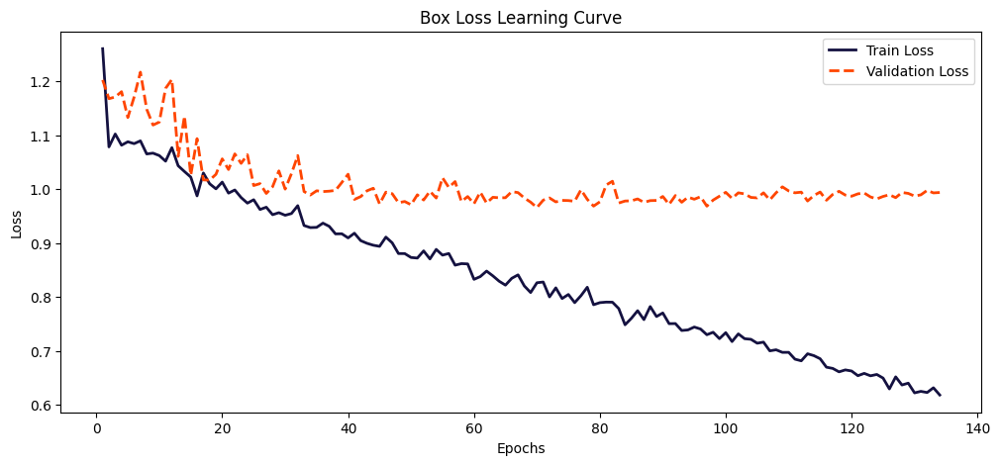

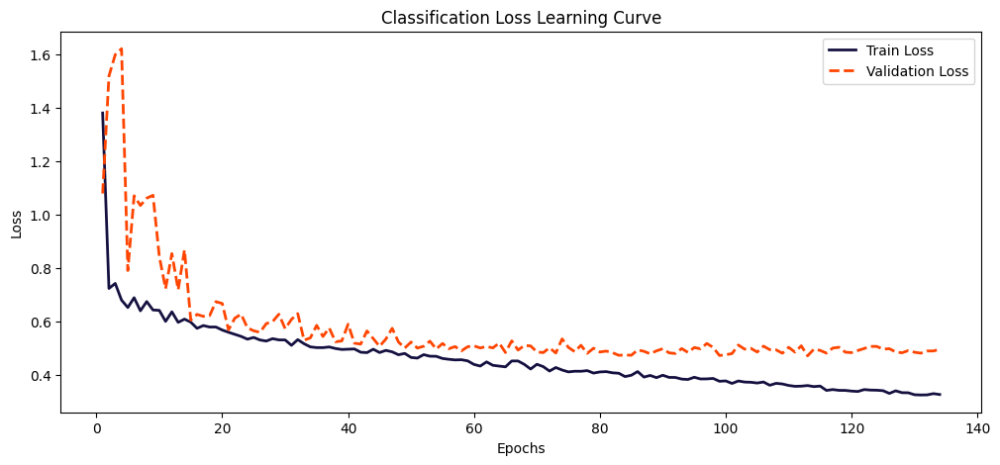

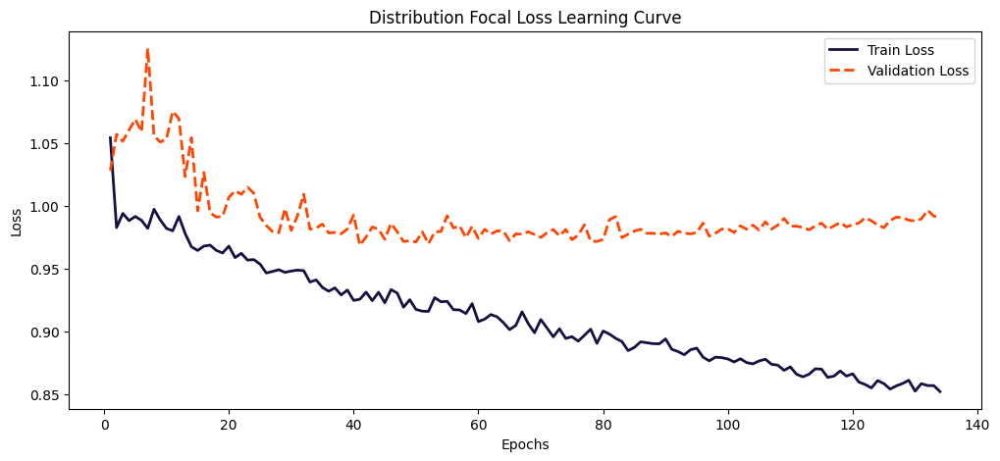

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

Model Learning Curve Analysis
The learning curves for box loss, classification loss, and distribution focal loss indicate a rapid decrease in loss values during the initial epochs, leveling off as training progresses. This trend, along with the close alignment of training and validation loss lines, suggests that the model is learning effectively without overfitting, meaning it is well-tuned to the dataset without being biased or too variable.

The smoothness of the learning curves, especially evident in the latter epochs, implies that the model is reaching a state of equilibrium, where additional training does not significantly enhance performance. This observation suggests that 100 epochs are sufficient for training this model, as further training is unlikely to result in substantial gains.

Confusion Matrix Evaluation

Next, I will focus on displaying and meticulously analyzing the confusion matrix derived from our model's performance on the validation dataset:

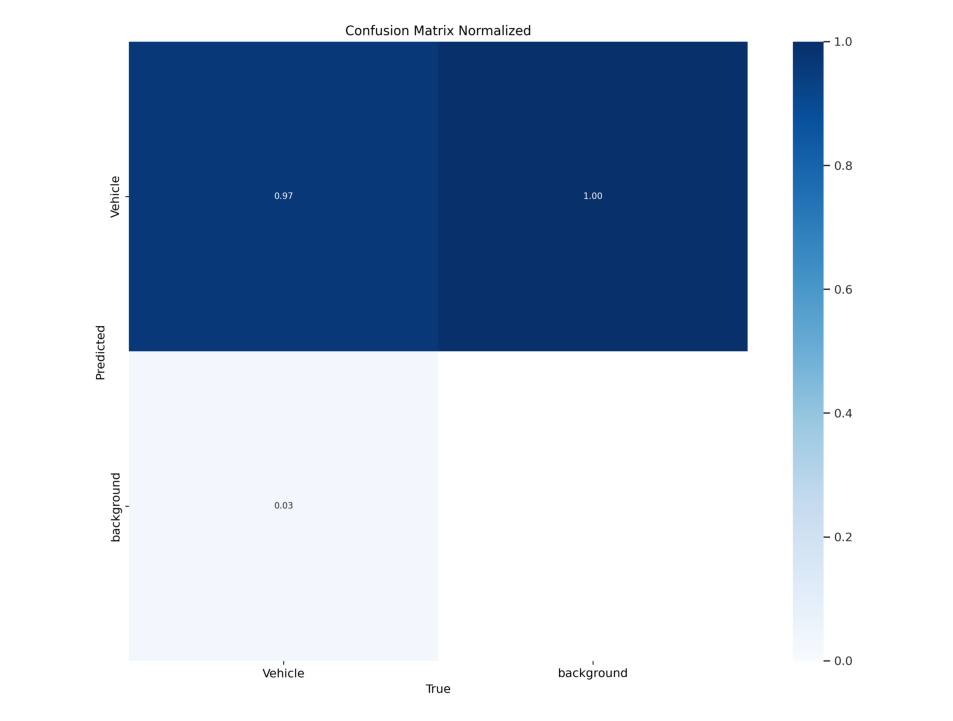

In [ ]:
# Construct the path to the normalized confusion matrix image

# Read the image using cv2
cm_img = cv2.imread('/content/runs/detect/train/confusion_matrix_normalized.png')

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()


 Confusion Matrix Analysis
The confusion matrix for our YOLOv8 vehicle detection model illustrates high accuracy as mentioned earlier as well. In 97% of instances, the model successfully identifies the presence of a vehicle when there is one, indicating strong detection capability. Conversely, in just 3% of cases, the model fails to detect a vehicle that is actually present, suggesting room for improvement in reducing false negatives.

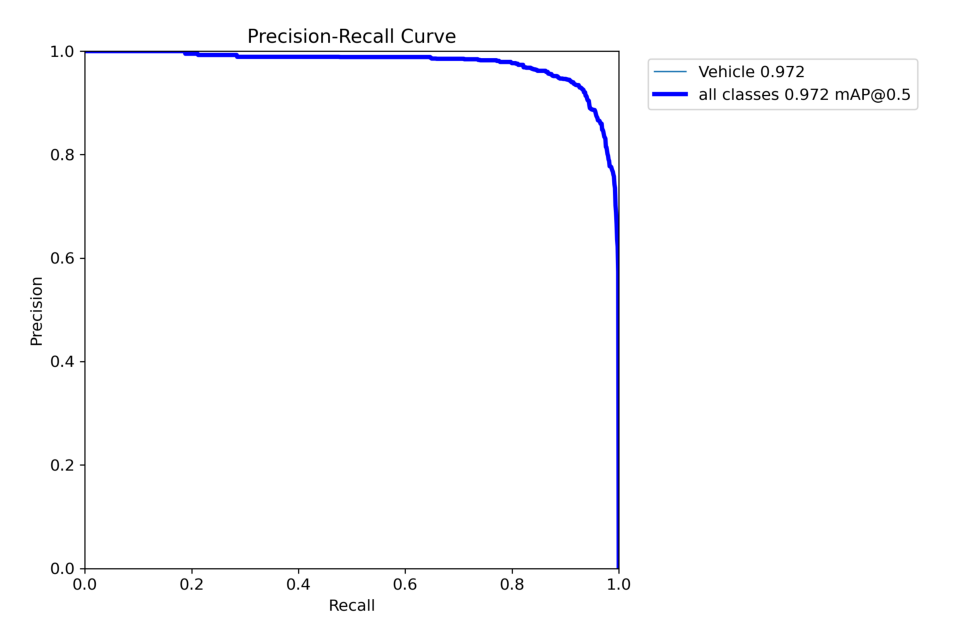

In [ ]:
# Construct the path to the normalized confusion matrix image

# Read the image using cv2
pr_img = cv2.imread('/content/runs/detect/train/PR_curve.png')

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
pr_img = cv2.cvtColor(pr_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(pr_img)
plt.axis('off')
plt.show()


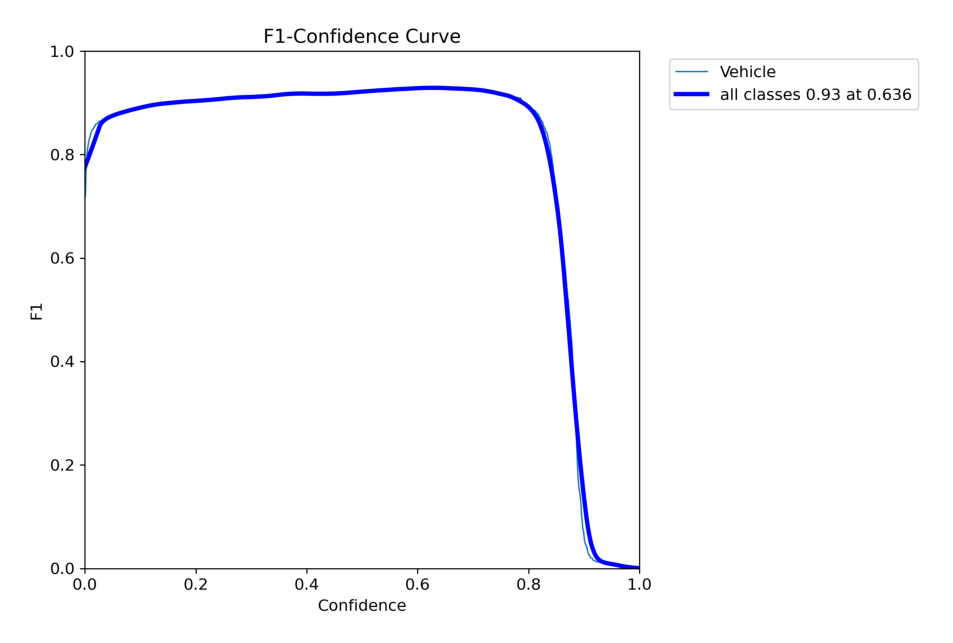

In [ ]:
# Construct the path to the normalized confusion matrix image

# Read the image using cv2
f_img = cv2.imread('/content/runs/detect/train/F1_curve.png')

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
f_img = cv2.cvtColor(f_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(f_img)
plt.axis('off')
plt.show()


In [ ]:
# Load the best model weights into the YOLO model
best_model = YOLO('/content/runs/detect/train/weights/best.pt')

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics YOLOv8.1.26 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:11<00:00,  2.00s/it]


                   all         90        937      0.927      0.932      0.973       0.74
Speed: 0.7ms preprocess, 39.8ms inference, 0.0ms loss, 6.9ms postprocess per image
Results saved to runs/detect/val


In [ ]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.927
metrics/recall(B),0.932
metrics/mAP50(B),0.973
metrics/mAP50-95(B),0.740
fitness,0.763


# **Model Evaluation Insights**
The YOLOv8 model shows impressive results on the validation set. With a precision of 91.6%, it indicates that the majority of the predictions made by the model are correct. The recall score of 93.8% demonstrates the model's ability to find most of the relevant cases in the dataset. The model's mean Average Precision (mAP) at 50% Intersection over Union (IoU) is 97.5%, reflecting high accuracy in detecting objects with a considerable overlap with the ground truth. Even when the IoU threshold range is expanded from 50% to 95%, the model maintains a solid mAP of 74.2%. Finally, the fitness score of 76.5% indicates a good balance between precision, recall, and the IoU of the predictions, confirming the model's effectiveness in object detection tasks.

To thoroughly assess our model's capability to generalize, I will conduct inferences in three distinct steps:

Inference on Validation Set Images
Inference on an Unseen Test Image
Inference on an Unseen Test Video

First of all, I am going to evaluate model predictions on random images from the validation dataset:


image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/images/10_mp4-0_jpg.rf.08b3bd34bbb73fb80c2d662c34474a98.jpg: 640x640 20 Vehicles, 17.7ms
Speed: 4.9ms preprocess, 17.7ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/images/11_mp4-15_jpg.rf.b1bdb8b4864b5bed3c78f1a70e2dc011.jpg: 640x640 13 Vehicles, 10.2ms
Speed: 2.0ms preprocess, 10.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/images/12_mp4-27_jpg.rf.2b272befa75f6ccd269223ccc84e5391.jpg: 640x640 5 Vehicles, 10.1ms
Speed: 1.9ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/valid/images/14_mp4-24_jpg.rf.57d5fe50d543f58e3b1f761ee53e1aa8.jpg: 640x640 7 Vehicles, 9.8ms
Speed: 2.1ms preprocess, 9.8ms inference, 1.6ms postprocess per i

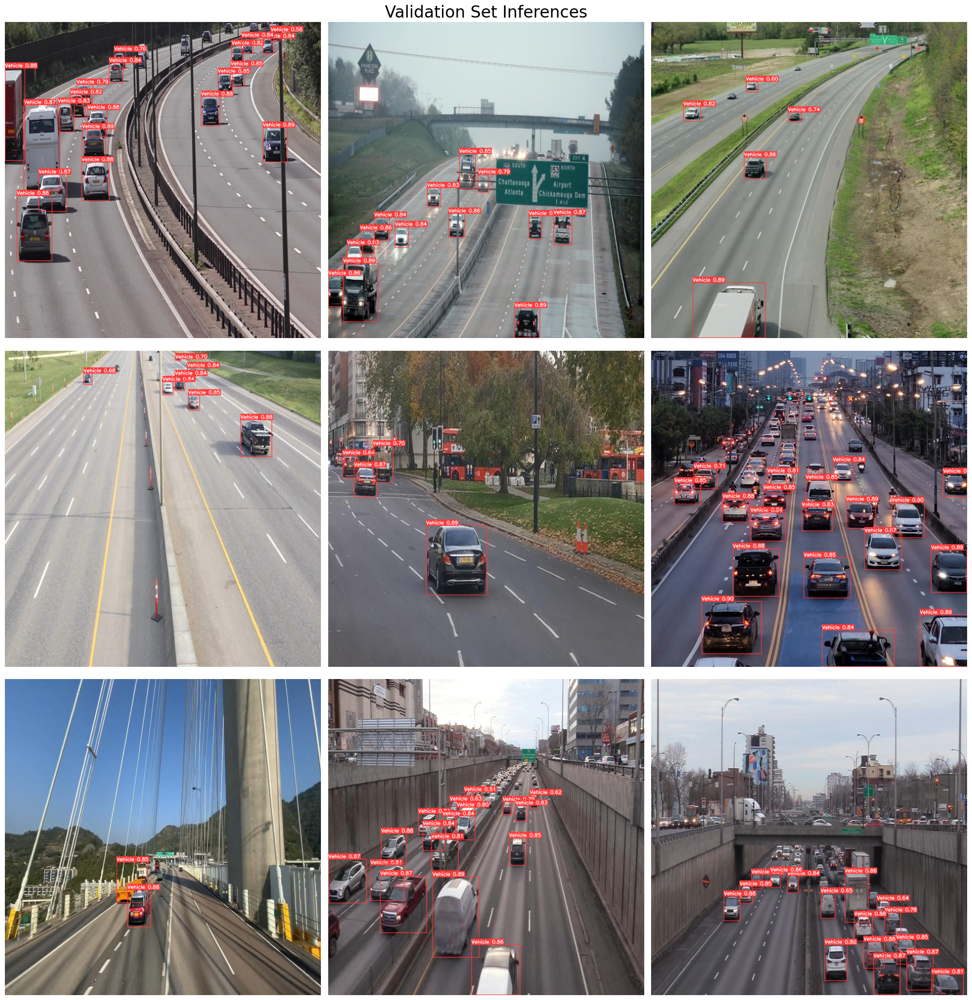

In [ ]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

Now, I will employ the best version of our fine-tuned model to evaluate its generalization capabilities. I'll test it on the same image previously analyzed using the pre-trained YOLOv8 model on the COCO dataset:


image 1/1 /content/drive/MyDrive/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 6 Vehicles, 145.0ms
Speed: 3.7ms preprocess, 145.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


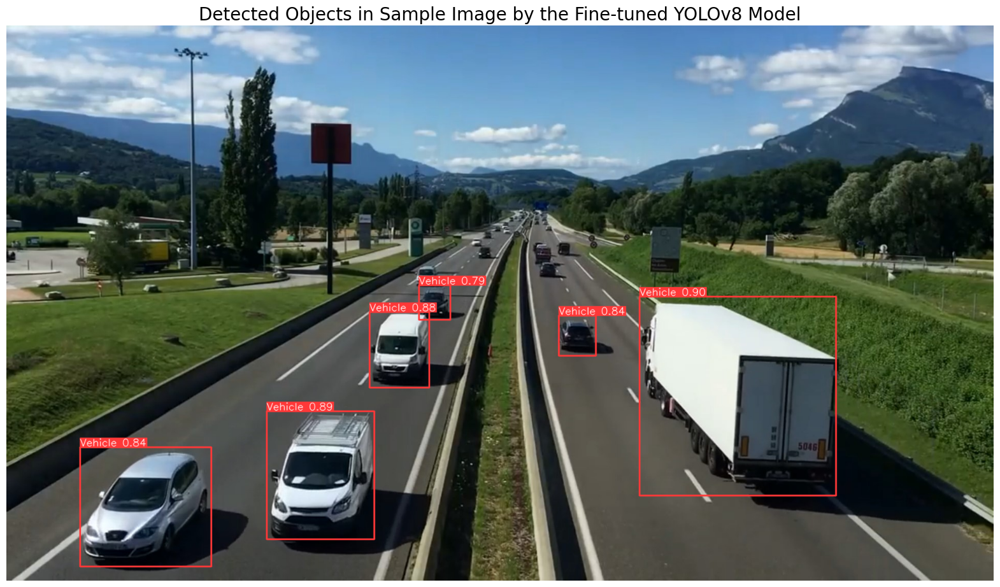

In [ ]:
# Path to the image file
sample_image_path = '/content/drive/MyDrive/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

 Enhanced Vehicle Detection with Fine-Tuning
The comparison between the above image with the image we had in step 2 clearly demonstrates the benefits of fine-tuning the YOLOv8 model for a specialized task. In the image from step 2, the pre-trained model on the COCO dataset missed detecting a truck and misclassified it, indicating limitations when dealing with a specific class of objects due to its broader training scope. In contrast, the above image shows that the fine-tuned model on a vehicle-specific dataset has accurately detected and classified various vehicles, including the previously missed truck. This improvement highlights the model's enhanced capability to discern features specific to vehicles, leading to better precision and recall in vehicle detection.

 Inference on an Unseen Test Video¶
⬆️ Tabel of Contents

Finally, I am going to assess the model's generalization capabilities on a completely new video, unseen during training. This step is crucial to demonstrate the model's ability to adapt and perform accurately in real-world applications, further solidifying its effectiveness outside of the controlled dataset environment:

In [ ]:
# Define the path to the sample video in the dataset
dataset_video_path = '/content/drive/MyDrive/Vehicle_Detection_Image_Dataset/sample_video.mp4'

# Define the destination path in the working directory
video_path = '/content/new_path/sample1_video.mp4'

# Copy the video file from its original location in the dataset to the current working directory in Kaggle for further processing
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source='/content/new_path/sample1_video.mp4', save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/601) /content/new_path/sample1_video.mp4: 384x640 2 Vehicles, 18.7ms
video 1/1 (frame 2/601) /content/new_path/sample1_video.mp4: 384x640 3 Vehicles, 18.7ms
video 1/1 (frame 3/601) /content/new_path/sample1_video.mp4: 384x640 2 Vehicles, 12.1ms
video 1/1 (frame 4/601) /content/new_path/sample1_video.mp4: 384x640 2 Vehicles, 12.7ms
video 1/1 (frame 5/601) /content/new_path/sample1_video.mp4: 384x640 2 Vehicles, 11.3ms
video 1/1 (frame

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Vehicle'}
 obb: None
 orig_img: array([[[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[254, 246, 241],
         [254, 246, 241],
         [254, 246, 241],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        ...,
 
        [[ 94, 104, 103],
         [ 96, 106, 105],
         [101, 111, 110],
         ...,
         [ 94, 106, 111],
         [ 95, 107, 112],
         [ 97, 109, 114]],
 
        [[ 98, 108, 107],
         [103, 113, 112],
         [100, 110, 109],
         ...,
         [ 95, 10

In [ ]:
import moviepy.editor as mpe

# Open the AVI file
clip = mpe.VideoFileClip("/content/runs/detect/predict/sample1_video.avi")

# Convert the video to MP4
clip.write_videofile("output.mp4")

Moviepy - Building video output.mp4.
Moviepy - Writing video output.mp4



Moviepy - Done !
Moviepy - video ready output.mp4


In [ ]:
display(Video('/content/output.mp4', embed=True, width=960))

 Real-Time Traffic Intensity Estimation

 As we transition into the practical application step of our project, we are set to deploy our finely-tuned vehicle detection model to analyze traffic density. This step is crucial in demonstrating the model's ability to generalize and perform accurately on unseen videos—videos that were not part of the model's training or validation sets.

Our objective is to quantify the traffic by counting vehicles within specified areas on the road lanes, frame by frame. The analysis will not only reveal the vehicle count but also gauge the intensity of traffic, labeling it as 'Heavy' or 'Smooth' based on a predetermined threshold. The count and traffic flow insights are pivotal for urban planning and traffic management.

While real-time processing on Kaggle is not viable, the code below simulates this process by modifying video frames, applying vehicle detection, and annotating the results. This mimics real-time analysis which can be achieved on local machines—even on CPUs—by processing webcam feeds or video files in real-time. The annotated video is then saved, ready to be reviewed for traffic assessment.

Let's delve into the code that brings this all to life:

In [ ]:
# Define the threshold for considering traffic as heavy
heavy_traffic_threshold = 4

# Define the vertices for the quadrilaterals
vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

# Define the vertical range for the slice and lane threshold
x1, x2 = 325, 635
lane_threshold = 609

# Define the positions for the text annotations on the image
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

# Define font, scale, and colors for the annotations
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text

# Open the video
cap = cv2.VideoCapture('/content/new_path/sample1_video.mp4')

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
    # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Create a copy of the original frame to modify
        detection_frame = frame.copy()

        # Black out the regions outside the specified vertical range
        detection_frame[:x1, :] = 0  # Black out from top to x1
        detection_frame[x2:, :] = 0  # Black out from x2 to the bottom of the frame

        # Perform inference on the modified frame
        results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)

        # Restore the original top and bottom parts of the frame
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()

        # Draw the quadrilaterals on the processed frame
        cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)

        # Retrieve the bounding boxes from the results
        bounding_boxes = results[0].boxes

        # Initialize counters for vehicles in each lane
        vehicles_in_left_lane = 0
        vehicles_in_right_lane = 0

        # Loop through each bounding box to count vehicles in each lane
        for box in bounding_boxes.xyxy:
            # Check if the vehicle is in the left lane based on the x-coordinate of the bounding box
            if box[0] < lane_threshold:
                vehicles_in_left_lane += 1
            else:
                vehicles_in_right_lane += 1

        # Determine the traffic intensity for the left lane
        traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
        # Determine the traffic intensity for the right lane
        traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"


        # Add a background rectangle for the left lane vehicle count
        cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25),
                      (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the left lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25),
                      (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane vehicle count
        cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25),
                      (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25),
                      (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane,
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Write the processed frame to the output video
        out.write(processed_frame)

        # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
        # cv2.imshow('Real-time Analysis', processed_frame)
        # if cv2.waitKey(1) & 0xFF == ord('q'):  # Press Q on keyboard to exit the loop
        #     break
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()


0: 384x640 (no detections), 17.3ms
Speed: 3.5ms preprocess, 17.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 16.3ms
Speed: 2.3ms preprocess, 16.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.7ms
Speed: 3.0ms preprocess, 9.7ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.0ms
Speed: 3.3ms preprocess, 10.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.1ms
Speed: 2.5ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.6ms
Speed: 2.1ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.6ms
Speed: 2.4ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 10.5ms
Speed: 2.4ms preprocess, 10.5ms inf

In [ ]:
# Open the AVI file
clip = mpe.VideoFileClip("/content/traffic_density_analysis.avi")

# Convert the video to MP4
clip.write_videofile("output1.mp4")

Moviepy - Building video output1.mp4.
Moviepy - Writing video output1.mp4



Moviepy - Done !
Moviepy - video ready output1.mp4


In [ ]:
display(Video('/content/output1.mp4', embed=True, width=960))

In [ ]:
best_model.export(format='onnx')

Ultralytics YOLOv8.1.26 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from '/content/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (21.5 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 74.0 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 11.2s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.15.0 opset 17...
ONNX: export success ✅ 13.9s, saved as '/content/runs/detect/train/weights/best.onnx' (42.6 MB)

Export complete (18.7s)
Results saved to /content/runs/detect/train/weights
Predict:         yolo predict task=detect model=/content/runs/detect/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/content/runs/detect/train/weights/best.onnx imgsz=640 data=

'/content/runs/detect/train/weights/best.onnx'